# Custom Dot Detection by Threshold Optimization

In [1]:
#custom function
from dot_detection_peaklocal_rad_gaus import *
#enhance figure display
%config InlineBackend.figure_format = 'retina'

In [2]:
import plotly.express as px
import plotly.graph_objects as go
import numpy as np

def plot_2d_locs_on_2d_image(df_locs_2d_1, df_locs_2d_2, img_2d,add_trace = True, zmax=1000):
    
    #For Plotting 2d image
    #-------------------------------------------
    fig = px.imshow(
        img_2d,
        width=700,
        height=700,
        binary_string=True,
        binary_compression_level=4,
        binary_backend='pil',
        zmax = zmax
    )
    #-------------------------------------------
    
    #For Plotting 2d dots
    #-------------------------------------------
    fig.add_trace(go.Scattergl(
        x=df_locs_2d_1.x,
        y=df_locs_2d_1.y,
        mode='markers',
        marker_symbol='cross',
        marker=dict(
            #maxdisplayed=1000,
            size=4
            ),
        name = "Gaussian"
        )
    )
    if add_trace == True:
        fig.add_trace(go.Scattergl(
            x=df_locs_2d_2.x,
            y=df_locs_2d_2.y,
            mode='markers',
            marker_symbol='cross',
            marker=dict(
                #maxdisplayed=1000,
                size=4
                ),
            name = "LoG"
            )
        )
    #-------------------------------------------
    
    fig.show()
    
def plot_3d_locs_on_2d_image(df_tiff_1, df_tiff_2, tiff, channel, 
                             raw_src = None, raw_image = False, add_trace = True, zmax=10):
    
    if raw_image == False:

        #PLot All Z's that had dot detection
        #-------------------------------------------
        for z in range(len(tiff[:,channel])):
            if add_trace == False:
                df_locs_2d_1 = df_tiff_1[(df_tiff_1.z > z-1) & (df_tiff_1.z < z+1)]
                plot_2d_locs_on_2d_image(df_locs_2d_1, None, tiff[z, channel], zmax=zmax, add_trace=add_trace)
            else:
                df_locs_2d_1 = df_tiff_1[(df_tiff_1.z > z-1) & (df_tiff_1.z < z+1)]
                df_locs_2d_2= df_tiff_2[(df_tiff_2.z > z-1) & (df_tiff_2.z < z+1)]
                plot_2d_locs_on_2d_image(df_locs_2d_1,df_locs_2d_2, tiff[z, channel],add_trace=add_trace, zmax=zmax)
    else:
        #read raw image
        tiff = tf.imread(raw_src)
        print("shape =", tiff.shape)
        #plot
        for z in range(len(tiff[:,channel])):
            if add_trace == False:
                df_locs_2d_1 = df_tiff_1[(df_tiff_1.z > z-1) & (df_tiff_1.z < z+1)]
                plot_2d_locs_on_2d_image(df_locs_2d_1,None, tiff[z, channel], zmax=zmax, add_trace=add_trace)
            else:
                df_locs_2d_1 = df_tiff_1[(df_tiff_1.z > z-1) & (df_tiff_1.z < z+1)]
                df_locs_2d_2= df_tiff_2[(df_tiff_2.z > z-1) & (df_tiff_2.z < z+1)]
                plot_2d_locs_on_2d_image(df_locs_2d_1,df_locs_2d_2, tiff[z, channel],add_trace=add_trace, zmax=zmax)

Threshold 200.0 completed after 0.9137411117553711 seconds
Threshold 321.21212121212125 completed after 0.9396369457244873 seconds
Threshold 216.16161616161617 completed after 1.0747597217559814 seconds
Threshold 256.5656565656566 completed after 1.276867151260376 seconds
Threshold 224.24242424242425 completed after 1.301358699798584 seconds
Threshold 337.3737373737374 completed after 1.4664697647094727 seconds
Threshold 296.969696969697 completed after 1.4823384284973145 seconds
Threshold 232.32323232323233 completed after 1.4885377883911133 seconds
Threshold 305.0505050505051 completed after 1.4894990921020508 seconds
Threshold 280.80808080808083 completed after 1.5002772808074951 seconds
Threshold 313.13131313131316 completed after 1.5042810440063477 seconds
Threshold 345.4545454545455 completed after 1.5518121719360352 seconds
Threshold 353.5353535353536 completed after 1.6069903373718262 seconds
Threshold 361.61616161616166 completed after 1.7534291744232178 seconds
Threshold 434.

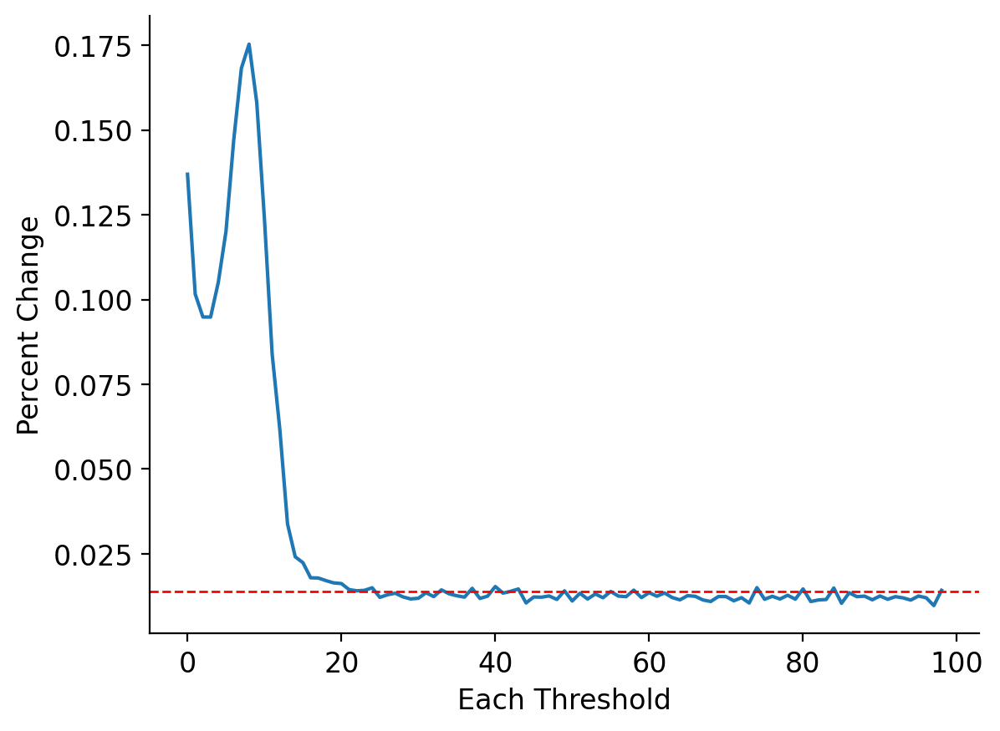

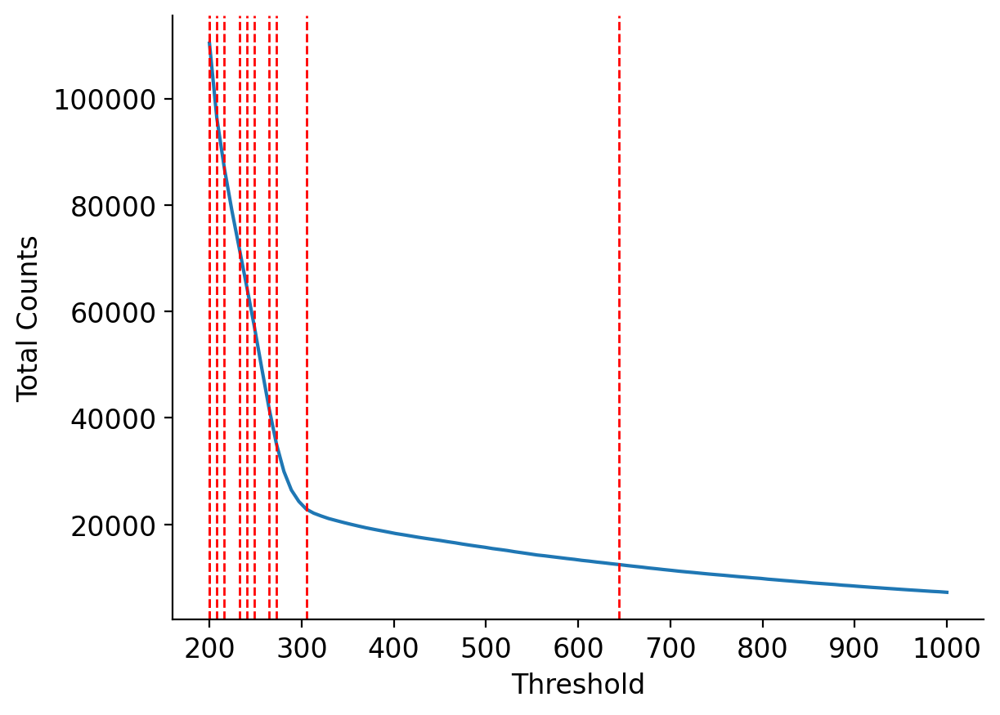

In [9]:
#test find threshold parameters
img_src = "/groups/CaiLab/personal/Lex/raw/112221_20kdash_3t3/notebook_pyfiles/deconvoluted_images/HybCycle_0/MMStack_Pos0.ome.tif"

final = find_threshold(img_src, box_size = 5,exclude_border=3, threshold_min = 200, 
                       threshold_max= 1000, interval=100, 
                       HybCycle = 0, channel = 0,
                       pos_start=0,pos_end=1,reduce_cutoff= 4, window=5)

In [ ]:
import time
#start time
start = time.time()

#image sources
img_src = "/groups/CaiLab/personal/Lex/raw/112221_20kdash_3t3/notebook_pyfiles/deconvoluted_images/HybCycle_0/MMStack_Pos0.ome.tif"
img_raw = '/groups/CaiLab/personal/Lex/raw/112221_20kdash_3t3/notebook_pyfiles/aberration_corrected/HybCycle_0/MMStack_Pos0.ome.tif'
raw_src=None

#img_src: path to image
#box_size: size of bounding box for peak local max detection
#exclude_border: number of pixels to exclude from the border
#channel: which channel you want to analyze
#pos: position number if check initial is True
#choose_thresh_set:which threshold set you want to use (if you have already ran full screen)
#hyb_number:total number of hybs for choose thresh set(if you are picking one)
#check_initial: check initial optimal threshold
#region_size: bounding box size for gaussian fit or radial centering
#gaussian: bool for performing gaussian fit
#radial_center: bool for radial centering
#optimize: bool to test different threshold and min dots
#output: bool to write out results or return data

dots = dot_detection(img_src, box_size = 5, exclude_border=3, HybCycle=0, size_cutoff=2, 
                     opt_thresh=300,channel=3,pos=0,choose_thresh_set = 6, hyb_number=80,
                     check_initial = False, region_size=7,
                     gaussian = False, radial_center=True, optimize=True, output=False)

print(f"This task took {(time.time() - start)/60} minutes")

In [68]:
dots

,hyb,ch,x,y,z,intensity,size
0,0,4,4.831797,6.887912,0,446,0.914724
1,0,4,286.346680,7.402807,0,946,1.077333
2,0,4,298.345198,7.486523,0,393,1.167212
3,0,4,324.097024,8.137445,0,597,1.296552
4,0,4,328.800843,6.731595,0,1269,0.989467
...,...,...,...,...,...,...,...
21291,0,4,845.954490,2039.404001,1,725,1.172867
21292,0,4,256.431372,2040.496319,1,310,1.272921
21293,0,4,829.172541,2039.629567,1,710,1.290690
21294,0,4,804.554556,2042.554639,1,318,1.436221


In [69]:
# #from dotdetection opt
# thresh = 4
# dots = pd.read_csv(f"/groups/CaiLab/personal/Lex/raw/Linus_10k_cleared_080918_NIH3T3/notebook_pyfiles/dots_comb/Channel_1_radialcenter/MMStack_Pos0/Threshold_{thresh}/Dot_Locations/locations_z_0.csv")

In [70]:
# #isolate hyb
# hyb = 0
# check = dots[dots["hyb"]==hyb]

shape = (2, 5, 2048, 2048)



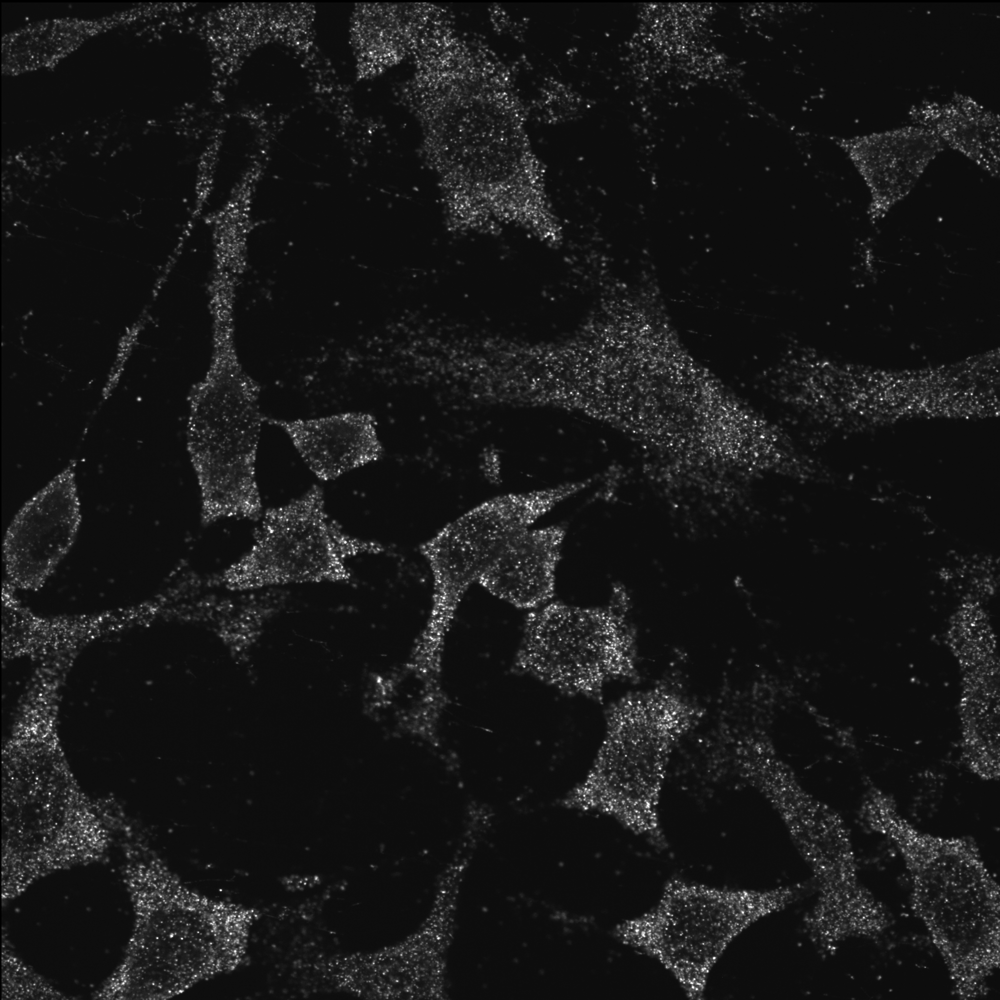


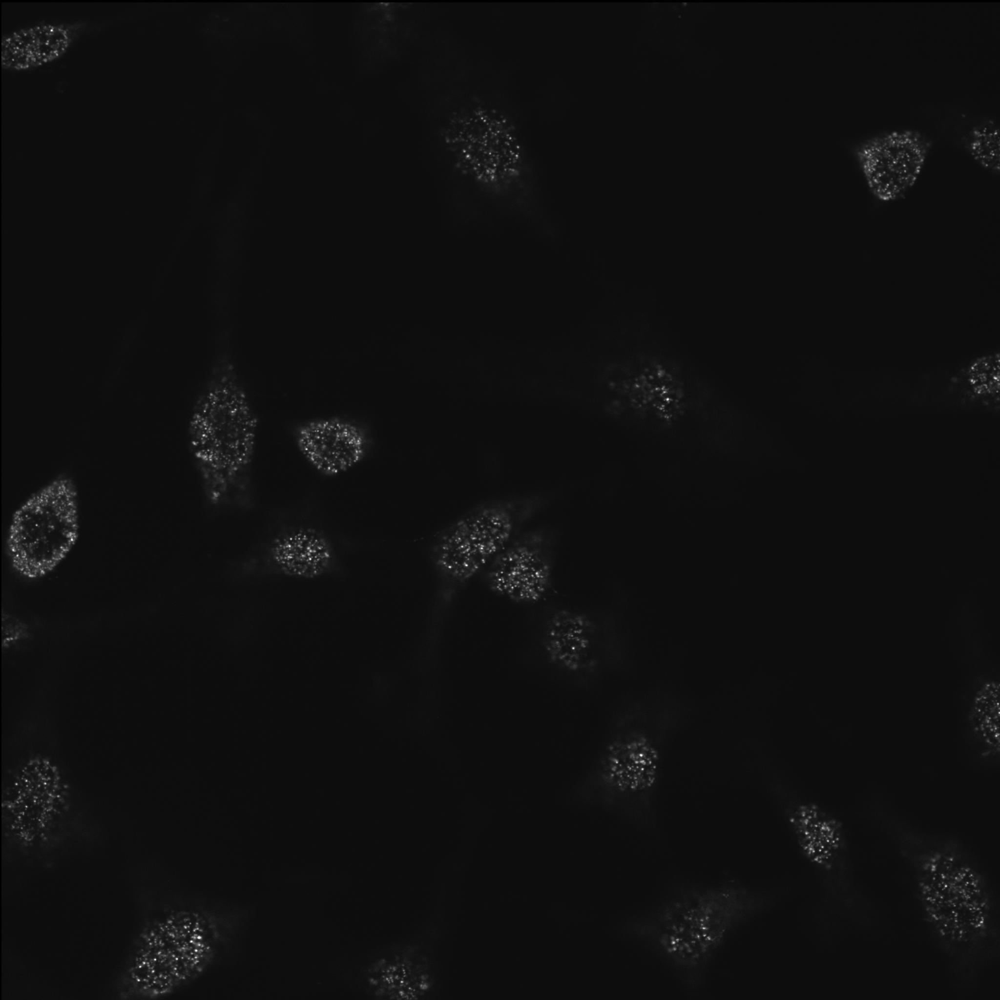

In [72]:
img_raw = '/groups/CaiLab/personal/Lex/raw/112221_20kdash_3t3/notebook_pyfiles/aberration_corrected/HybCycle_0/MMStack_Pos0.ome.tif'
plot_3d_locs_on_2d_image(dots,None, tiff=None, channel=3, raw_src = img_raw, 
                         raw_image = True, add_trace=False, zmax=2000)


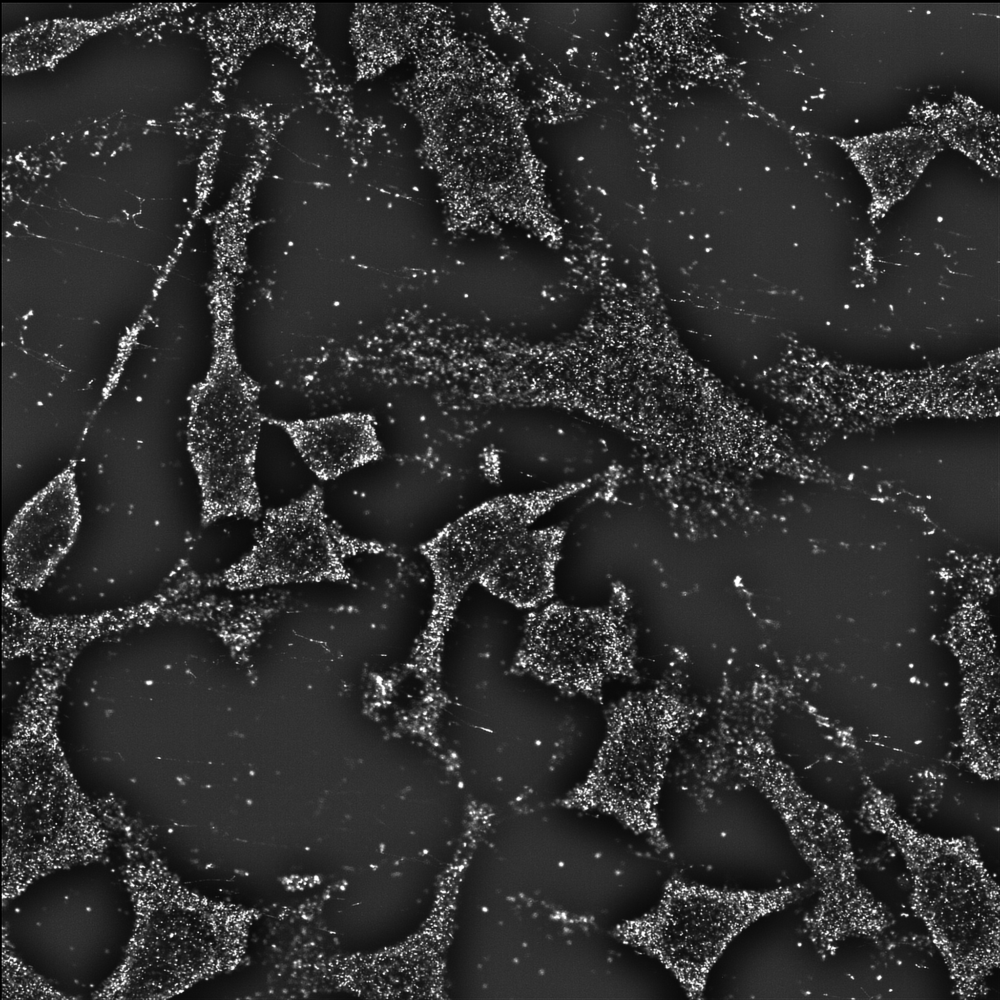


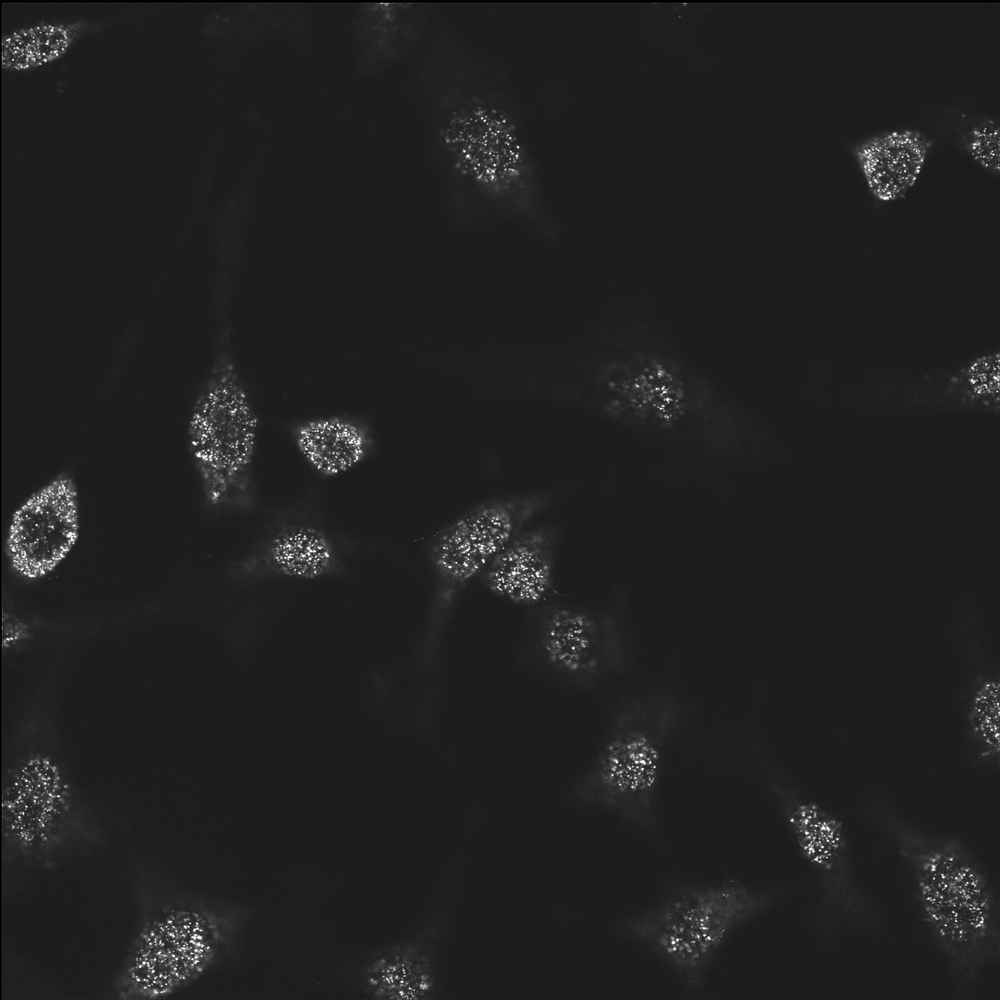

In [73]:
tiff = tf.imread(img_src)
plot_3d_locs_on_2d_image(dots,None, tiff=tiff, channel=3, 
                         raw_src = img_raw, raw_image = False,add_trace=False, zmax=1000)

# Organize dots detected files

In [10]:
#custom functions
from dot_detection_peaklocal_rad_gaus import combine_dot_files

In [75]:
path_dots = "/groups/CaiLab/personal/Lex/raw/112221_20kdash_3t3/notebook_pyfiles/dots_detected/Channel_4"
combine_dot_files(path_dots, hyb_start=0,hyb_end=12,num_HybCycle = 12,
                  pos = 0, channel=3, num_z = 2, opt_files = True)

# Check if there are weird dropouts in a certain hyb for each threshold

In [63]:
import pandas as pd
import seaborn as sns

In [79]:
#collect arrays
channel = 4
comb_dots_list = []
for i in range(11):
    path = f"/groups/CaiLab/personal/Lex/raw/112221_20kdash_3t3/notebook_pyfiles/dots_comb/Channel_{channel}/MMStack_Pos0/Threshold_{i}/Dot_Locations/locations_z_0.csv"
    arr1  = pd.read_csv(path)
    comb_dots_list.append(arr1)

In [80]:
final_counts = []
for df in comb_dots_list:
    dots_per_hyb = []
    for i in df["hyb"].unique():
        dots_per_hyb.append(len(df[df["hyb"]==i]))
    final_counts.append(dots_per_hyb)

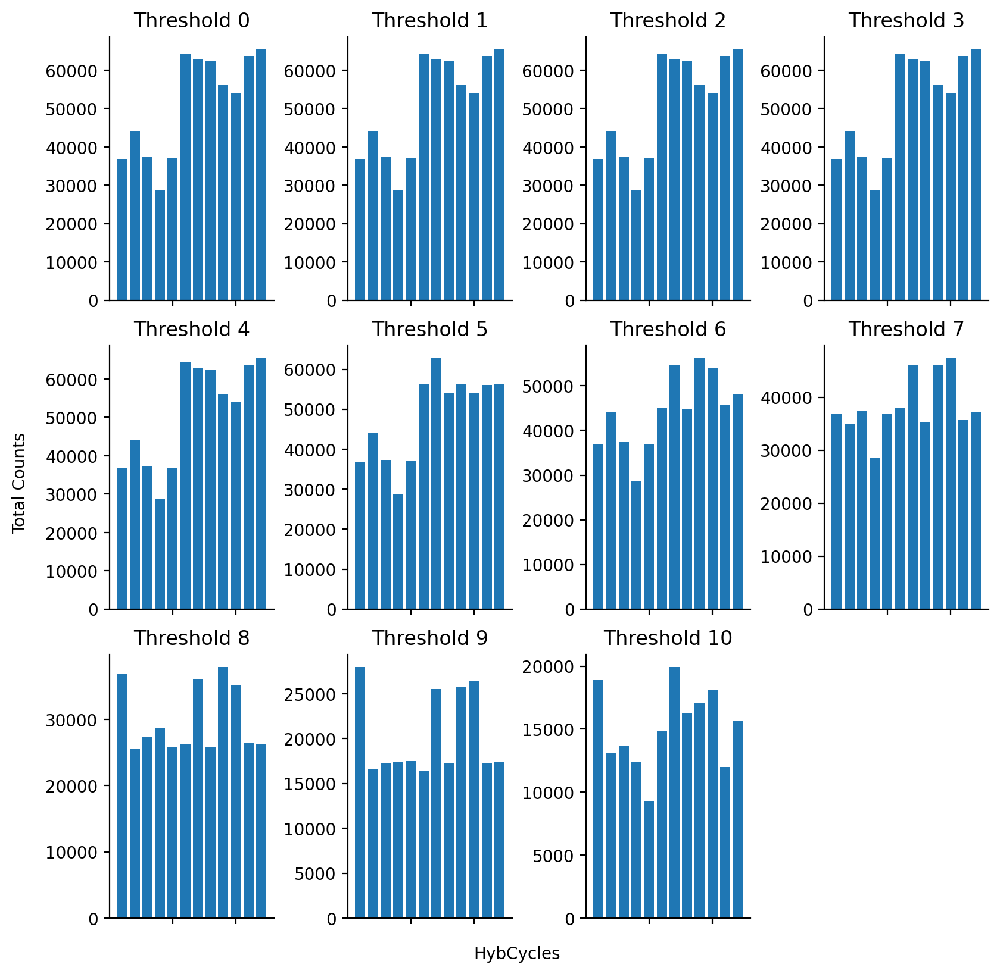

In [81]:
#generate subplot canvas
x = 4
fig, ax = plt.subplots(x, x, figsize=(8,10), sharex = True, constrained_layout=True)
fig.text(0.5, 0.2, 'HybCycles', ha='center')
fig.text(-0.03, 0.6, 'Total Counts', va='center', rotation='vertical')
i = 0

#fill subplots
for row in ax:
    for col in row:
        try:
            #generate scatter plot of gene
            col.bar(x=np.arange(1,len(final_counts[i])+1,1) ,height=final_counts[i])
            sns.despine()
            col.set_title(f"Threshold {i}")
        except IndexError:
            col.remove()
        i += 1
plt.show()

# Combine threshold channels (for dash)

In [95]:
channel = [1,2,3,4]
z = 1
df_list = []
for i in range(11):
    thresh_df = []
    for c in channel:
        paths = f"/groups/CaiLab/personal/Lex/raw/112221_20kdash_3t3/notebook_pyfiles/dots_comb/Channel_{c}/MMStack_Pos0/Threshold_{i}/Dot_Locations/locations_z_{z}.csv"
        df = pd.read_csv(paths)
        thresh_df.append(df)
    df_comb = pd.concat(thresh_df)
    df_list.append(df_comb)

In [96]:
from pathlib import Path

for i in range(len(df_list)):
    df = df_list[i].reset_index(drop=True)
    path = Path(f"/groups/CaiLab/personal/Lex/raw/112221_20kdash_3t3/notebook_pyfiles/dots_comb/channels_combined/Threshold_{i}")
    path.mkdir(parents=True,exist_ok=True)
    output = path / f"locations_z_{z}.csv"
    df.to_csv(str(output))

In [98]:
pd.read_csv("../../dots_comb/channels_combined/Threshold_0/locations_z_1.csv")

,Unnamed: 0,hyb,ch,x,y,z,intensity,size
0,0,0,1,7.446642,6.595701,1,212,1.250510
1,1,0,1,526.437856,7.290932,1,239,1.393828
2,2,0,1,530.187055,7.126036,1,276,1.292837
3,3,0,1,553.585966,6.479688,1,268,1.293512
4,4,0,1,554.618415,7.402088,1,268,1.359418
...,...,...,...,...,...,...,...,...
623162,623162,11,4,256.082483,2042.880387,1,289,1.431797
623163,623163,11,4,274.825902,2045.227923,1,222,1.989856
623164,623164,11,4,281.477811,2043.020053,1,252,1.497856
623165,623165,11,4,288.180432,2044.695494,1,227,1.938054
